<h1>Table of Contents<span class="tocSkip"></span></h1>
<div class="toc"><ul class="toc-item"><li><span><a href="#Location-of-the-weather-station" data-toc-modified-id="Location-of-the-weather-station-1"><span class="toc-item-num">1&nbsp;&nbsp;</span>Location of the weather station</a></span></li><li><span><a href="#XGBoost-Regressor" data-toc-modified-id="XGBoost-Regressor-2"><span class="toc-item-num">2&nbsp;&nbsp;</span>XGBoost Regressor</a></span></li><li><span><a href="#LSTM-Temperature" data-toc-modified-id="LSTM-Temperature-3"><span class="toc-item-num">3&nbsp;&nbsp;</span>LSTM Temperature</a></span></li><li><span><a href="#LSTM-Wind-speed" data-toc-modified-id="LSTM-Wind-speed-4"><span class="toc-item-num">4&nbsp;&nbsp;</span>LSTM Wind speed</a></span></li><li><span><a href="#XGBoost-Regressor-for-2018" data-toc-modified-id="XGBoost-Regressor-for-2018-5"><span class="toc-item-num">5&nbsp;&nbsp;</span>XGBoost Regressor for 2018</a></span></li></ul></div>

## Location of the weather station

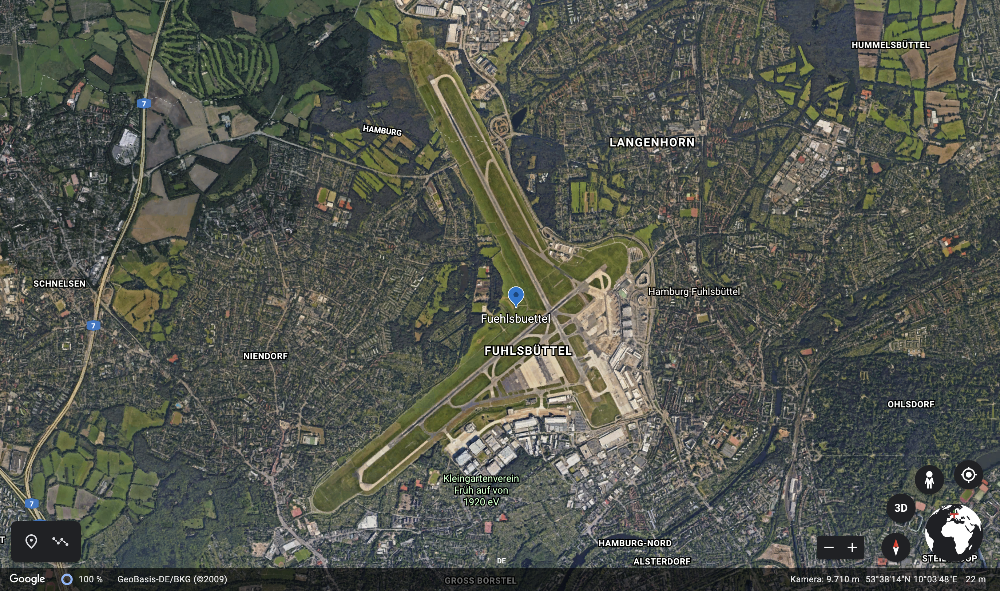

In [74]:
## load cleaned weather data
import pandas as pd
import numpy as np
import xgboost as xgb
import plotly as py
import plotly.graph_objects as go
from sklearn.ensemble import GradientBoostingRegressor
from keras.models import Sequential
from keras.layers import Dense
from keras.layers import LSTM
from keras.layers import Dropout
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import r2_score,mean_squared_error,mean_absolute_error

df = pd.read_csv('weather_data_cleaned.csv', index_col='MESS_DATUM', parse_dates=True)
df = df.iloc[:,1:]

## XGBoost Regressor

In [4]:
X = df[['ATMO_LBERG', 'FD_LBERG', 'FG_LBERG', 'ZENIT', 'V_VV', 'V_N','V_TE005']]
Y = df.TT_TU

X_train = X.loc[:'2019-10-28']
X_test = X.loc['2019-10-29']
Y_train = Y.loc[:'2019-10-28']
Y_test = Y.loc['2019-10-29']
    
model = xgb.XGBRegressor(n_estimators=2000,learning_rate=0.7)
model.fit(X_train,Y_train)
y_pred = model.predict(data=X_test)
#print(mean_absolute_error(Y_test.values.ravel(), y_pred))

fig = go.Figure()
x  = Y_test.index
y1 = y_pred
y2 = Y_test.values

fig.add_trace(go.Scatter(x=x, y=y2,
                         name='measured',
                         line_color='#1468A2',
                         line_width=3)) 
fig.add_trace(go.Scatter(x=x, y=y1,
                         name='predicted',
                         line_color='#FFCA1B',
                         line_width=3)) 

fig.update_layout(title_text='XGBoostRegressor 29.10.2019',
                  yaxis_title = 'Temperature [°C]',
                  xaxis_title = 'Time',
                  plot_bgcolor='#F0F0F0')

fig.show()


In [46]:
X = df[['ATMO_LBERG', 'FD_LBERG', 'FG_LBERG', 'ZENIT', 'V_VV', 'V_N','V_TE005']]
Y = df.TT_TU

X_train = X.loc[:'2019-01-08']
X_test = X.loc['2019-01-09']
Y_train = Y.loc[:'2019-01-08']
Y_test = Y.loc['2019-01-09']
   
model = xgb.XGBRegressor(n_estimators=2000,learning_rate=0.7)
model.fit(X_train,Y_train)
y_pred = model.predict(data=X_test)

fig = go.Figure()
x  = Y_test.index
y1 = y_pred
y2 = Y_test.values

fig.add_trace(go.Scatter(x=x, y=y2,
                         name='measured',
                         line_color='#1468A2',
                         line_width=3)) 
fig.add_trace(go.Scatter(x=x, y=y1,
                         name='predicted',
                         line_color='#FFCA1B',
                         line_width=3)) 
fig.update_yaxes(range=[-2, 8])

fig.update_layout(title_text='XGBoostRegressor 09.01.2019',
                  yaxis_title = 'Temperature [°C]',
                  xaxis_title = 'Time',
                  plot_bgcolor='#F0F0F0')

fig.show()


In [7]:
X = df[['FD_LBERG', 'FG_LBERG', 'ZENIT', 'RF_TU', 'V_N', 'P', 'DD', 'V_TE050']]
Y = df.FF

X_train = X.loc[:'2019-10-08']
X_test = X.loc['2019-10-09']
Y_train = Y.loc[:'2019-10-08']
Y_test = Y.loc['2019-10-09']
   
model = xgb.XGBRegressor(n_estimators=2000,learning_rate=0.7)
model.fit(X_train,Y_train)
y_pred = model.predict(data=X_test)

fig = go.Figure()
x  = Y_test.index
y1 = y_pred
y2 = Y_test.values

fig.add_trace(go.Scatter(x=x, y=y2,
                         name='measured',
                         line_color='#1468A2',
                         line_width=3)) 
fig.add_trace(go.Scatter(x=x, y=y1,
                         name='predicted',
                         line_color='#FFCA1B',
                         line_width=3)) 
fig.update_yaxes(range=[0, 14])

fig.update_layout(title_text='XGBoostRegressor 09.10.2019',
                  yaxis_title = 'Wind speed [m/s]',
                  xaxis_title = 'Time',
                  plot_bgcolor='#F0F0F0')

fig.show()

## LSTM Temperature

Epoch 1/20
122513/122513 [==============================] - 72s 590us/step - loss: 18.1177
Epoch 2/20
122513/122513 [==============================] - 73s 594us/step - loss: 5.9730
Epoch 3/20
122513/122513 [==============================] - 70s 575us/step - loss: 5.5105
Epoch 4/20
122513/122513 [==============================] - 69s 566us/step - loss: 5.1213
Epoch 5/20
122513/122513 [==============================] - 71s 576us/step - loss: 4.8454
Epoch 6/20
122513/122513 [==============================] - 70s 575us/step - loss: 4.6702
Epoch 7/20
122513/122513 [==============================] - 70s 574us/step - loss: 4.5340
Epoch 8/20
122513/122513 [==============================] - 71s 580us/step - loss: 4.4676
Epoch 9/20
122513/122513 [==============================] - 71s 579us/step - loss: 4.3968
Epoch 10/20
122513/122513 [==============================] - 71s 583us/step - loss: 4.4330
Epoch 11/20
122513/122513 [==============================] - 71s 581us/step - loss: 4.3194
Epoch 1

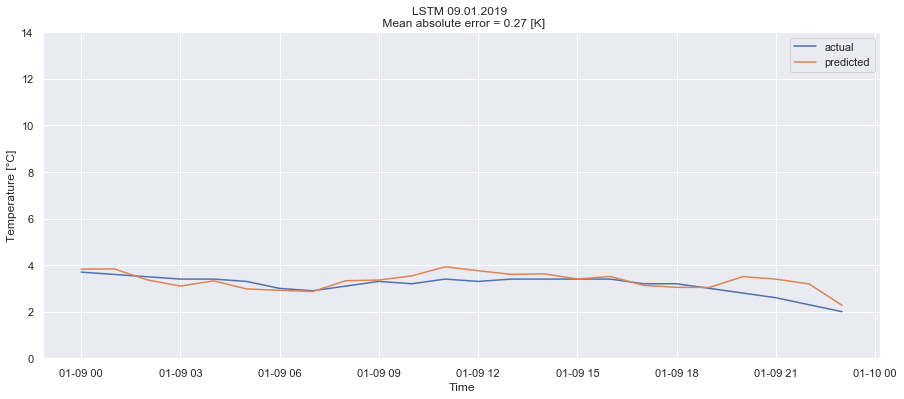

In [137]:
X = df[['ATMO_LBERG', 'FD_LBERG', 'FG_LBERG', 'ZENIT', 'V_VV', 'V_N','V_TE005']]
Y = df.TT_TU


X_train = X.loc[:'2019-01-08']
X_test = X.loc['2019-01-09']
Y_train = Y.loc[:'2019-01-08']
Y_test = Y.loc['2019-01-09']

X_train, Y_train = np.array(X_train), np.array(Y_train)
X_train = np.reshape(X_train, (X_train.shape[0], X_train.shape[1], 1))

X_test, Y_test = np.array(X_test), np.array(Y_test)
X_test = np.reshape(X_test, (X_test.shape[0], X_test.shape[1], 1))

# Stacked LSTM for Regression

regressor = Sequential()

regressor.add(LSTM(units = 60, return_sequences = True, input_shape = (X_train.shape[1], 1)))
regressor.add(Dropout(0.2))

regressor.add(LSTM(units = 60, return_sequences = True))
regressor.add(Dropout(0.2))

regressor.add(LSTM(units = 60, return_sequences = True))
regressor.add(Dropout(0.2))

regressor.add(LSTM(units = 60, return_sequences = True))
regressor.add(Dropout(0.2))

regressor.add(LSTM(units = 60))
regressor.add(Dropout(0.2))

regressor.add(Dense(units = 1))

regressor.compile(optimizer = 'adam', loss = 'mean_squared_error')

regressor.fit(X_train, Y_train, epochs = 20, batch_size = 50)
y_pred = regressor.predict(X_test)

Y_test = Y.loc['2019-01-09']
y_pred = pd.DataFrame(y_pred)
x = Y_test.index
sns.set()
plt.figure(figsize=(15,6))
plt.plot(x,Y_test.values)
plt.plot(x,y_pred.values)
plt.ylim(0,14)
plt.ylabel('Temperature [°C]')
plt.xlabel('Time')
labels=('actual','predicted')
plt.legend(labels)
mae = mean_absolute_error(Y_test.values.ravel(), y_pred)
plt.title('LSTM 09.01.2019 \n Mean absolute error = '+str(round(mae,2))+' [K]');

## LSTM Wind speed

Epoch 1/20
129053/129053 [==============================] - 51s 396us/step - loss: 4.1211
Epoch 2/20
129053/129053 [==============================] - 46s 358us/step - loss: 3.5044
Epoch 3/20
129053/129053 [==============================] - 47s 362us/step - loss: 3.4185
Epoch 4/20
129053/129053 [==============================] - 46s 359us/step - loss: 3.3680
Epoch 5/20
129053/129053 [==============================] - 47s 361us/step - loss: 3.3225
Epoch 6/20
129053/129053 [==============================] - 49s 382us/step - loss: 3.2443
Epoch 7/20
129053/129053 [==============================] - 57s 438us/step - loss: 3.1950
Epoch 8/20
129053/129053 [==============================] - 76s 588us/step - loss: 3.1741
Epoch 9/20
129053/129053 [==============================] - 76s 586us/step - loss: 3.1527
Epoch 10/20
129053/129053 [==============================] - 76s 588us/step - loss: 3.1418
Epoch 11/20
129053/129053 [==============================] - 76s 589us/step - loss: 3.1145
Epoch 12

Text(0.5, 1.0, 'LSTM 09.10.2019 \n Mean absolute error = 0.92 [m/s]')

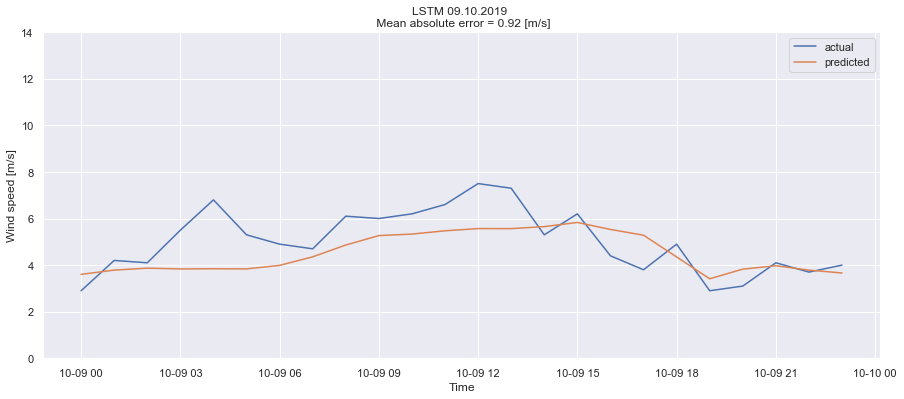

In [76]:
X = df[['FD_LBERG', 'FG_LBERG', 'ZENIT', 'RF_TU', 'V_N', 'P', 'DD', 'V_TE050']]
Y = df.FF

X_train = X.loc[:'2019-10-08']
X_test = X.loc['2019-10-09']
Y_train = Y.loc[:'2019-10-08']
Y_test = Y.loc['2019-10-09']

X_train, Y_train = np.array(X_train), np.array(Y_train)
X_train = np.reshape(X_train, (X_train.shape[0], X_train.shape[1], 1))

X_test, Y_test = np.array(X_test), np.array(Y_test)
X_test = np.reshape(X_test, (X_test.shape[0], X_test.shape[1], 1))

# Stacked LSTM for Regression

regressor = Sequential()

regressor.add(LSTM(units = 60, return_sequences = True, input_shape = (X_train.shape[1], 1)))
regressor.add(Dropout(0.2))

regressor.add(LSTM(units = 60, return_sequences = True))
regressor.add(Dropout(0.2))

regressor.add(LSTM(units = 60, return_sequences = True))
regressor.add(Dropout(0.2))

regressor.add(LSTM(units = 60, return_sequences = True))
regressor.add(Dropout(0.2))

regressor.add(LSTM(units = 60))
regressor.add(Dropout(0.2))

regressor.add(Dense(units = 1))

regressor.compile(optimizer = 'adam', loss = 'mean_squared_error')

regressor.fit(X_train, Y_train, epochs = 20, batch_size = 100)
y_pred = regressor.predict(X_test)

Y_test = Y.loc['2019-10-09']
y_pred = pd.DataFrame(y_pred)
x = Y_test.index
sns.set()
plt.figure(figsize=(15,6))
plt.plot(x,Y_test.values)
plt.plot(x,y_pred.values)
plt.ylim(0,14)
plt.ylabel('Wind speed [m/s]')
plt.xlabel('Time')
labels=('actual','predicted')
plt.legend(labels)
mae = mean_absolute_error(Y_test.values.ravel(), y_pred)
plt.title('LSTM 09.10.2019 \n Mean absolute error = '+str(round(mae,2))+' [m/s]')

## XGBoost Regressor for 2018

In [128]:
Y = df.TT_TU.loc['2018-01-01':'2018-12-31']

temp2018_XBG_500 = pd.read_csv('Temp_XGB_2018_500estimators.csv')

fig = go.Figure()
x = Y.index
y1 = temp2018_XBG_500.pred
y2 = Y.values

mae = mean_absolute_error(Y.values.ravel(), temp2018_XBG_500.pred) 

fig.add_trace(go.Scatter(x=x, y=y2,
                         name='measured',
                         line_color='#1468A2',
                         line_width=3)) 
fig.add_trace(go.Scatter(x=x, y=y1,
                         name='predicted',
                         line_color='#FFCA1B',
                         line_width=3)) 
fig.update_yaxes(range=[-15, 40])
title = 'XGBoostRegressor 01.01.2018 - 31.12.2018  Mean absolute error = '+str(round(mae,2))+' [K]= '+str(round((mae*100)/y2.mean(),1))+'%'
fig.update_layout(title_text = title,
                  yaxis_title = 'Temperature [°C]',
                  xaxis_title = 'Date',
                  plot_bgcolor='#F0F0F0')

fig.show()

In [126]:
Y = df.FF.loc['2018-01-01':'2018-12-31']

wind2018_XBG_500 = pd.read_csv('Wind_XGB_2018_500estimators.csv')

fig = go.Figure()
x = Y.index
y1 = wind2018_XBG_500.pred
y2 = Y.values

mae = mean_absolute_error(Y.values.ravel(), wind2018_XBG_500.pred)

fig.add_trace(go.Scatter(x=x, y=y2,
                         name='measured',
                         line_color='#1468A2',
                         line_width=3)) 
fig.add_trace(go.Scatter(x=x, y=y1,
                         name='predicted',
                         line_color='#FFCA1B',
                         line_width=3)) 
fig.update_yaxes(range=[0, 15])
title = 'XGBoostRegressor 01.01.2018 - 31.12.2018  Mean absolute error = '+str(round(mae,2))+' [m/s] = '+str(round((mae*100)/y2.mean(),1))+'%'
fig.update_layout(title_text = title,
                  yaxis_title = 'Wind speed [m/s]',
                  xaxis_title = 'Date',
                  plot_bgcolor='#F0F0F0')

fig.show()

In [132]:
Y = df.P.loc['2018-01-01':'2018-12-31']

press2018_XBG_500 = pd.read_csv('Press_XGB_2018_500estimators.csv')

fig = go.Figure()
x = Y.index
y1 = press2018_XBG_500.pred
y2 = Y.values

mae = mean_absolute_error(Y.values.ravel(), press2018_XBG_500.pred)

fig.add_trace(go.Scatter(x=x, y=y2,
                         name='measured',
                         line_color='#1468A2',
                         line_width=3)) 
fig.add_trace(go.Scatter(x=x, y=y1,
                         name='predicted',
                         line_color='#FFCA1B',
                         line_width=3)) 
fig.update_yaxes(range=[970, 1050])
title = 'XGBoostRegressor 01.01.2018 - 31.12.2018  Mean absolute error = '+str(round(mae,2))+' [mbar] = '+str(round((mae*100)/y2.mean(),1))+'%'
fig.update_layout(title_text = title,
                  yaxis_title = 'Pressure [mbar]',
                  xaxis_title = 'Date',
                  plot_bgcolor='#F0F0F0')

fig.show()